In [2]:
!pip install lxml
!pip install folium

In [3]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import matplotlib
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegressionCV
import sklearn.metrics as metrics
from sklearn.preprocessing import PolynomialFeatures
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn import tree
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc, roc_auc_score
import json
from sklearn.tree import export_graphviz
from IPython.display import Image
from IPython.display import display
from IPython.display import display, Math, Latex
%matplotlib inline
    
pd.set_option('display.width', 450)
pd.set_option('display.max_columns',100)
pd.set_option('display.notebook_repr_html', True)

In [4]:
import pandas as pd

sheet1 = None
with pd.ExcelFile(r"/Users/priyankakesari/Library/Containers/com.microsoft.Excel/Data/Desktop/Capstone Project/1582800386_project1datadictionary/data.xlsx") as reader:
    business_df = pd.read_excel(reader, sheet_name='zomato')


In [5]:
business_df.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
0,7402935,Skye,94,Jakarta,"Menara BCA, Lantai 56, Jl. MH. Thamrin, Thamri...","Grand Indonesia Mall, Thamrin","Grand Indonesia Mall, Thamrin, Jakarta",106.821999,-6.196778,"Italian, Continental",800000,Indonesian Rupiah(IDR),No,No,3,4.1,Green,Very Good,1498
1,7410290,Satoo - Hotel Shangri-La,94,Jakarta,"Hotel Shangri-La, Jl. Jend. Sudirman","Hotel Shangri-La, Sudirman","Hotel Shangri-La, Sudirman, Jakarta",106.818961,-6.203292,"Asian, Indonesian, Western",800000,Indonesian Rupiah(IDR),No,No,3,4.6,Dark Green,Excellent,873
2,7420899,Sushi Masa,94,Jakarta,"Jl. Tuna Raya No. 5, Penjaringan",Penjaringan,"Penjaringan, Jakarta",106.800144,-6.101298,"Sushi, Japanese",500000,Indonesian Rupiah(IDR),No,No,3,4.9,Dark Green,Excellent,605
3,7421967,3 Wise Monkeys,94,Jakarta,"Jl. Suryo No. 26, Senopati, Jakarta",Senopati,"Senopati, Jakarta",106.813400,-6.235241,Japanese,450000,Indonesian Rupiah(IDR),No,No,3,4.2,Green,Very Good,395
4,7422489,Avec Moi Restaurant and Bar,94,Jakarta,"Gedung PIC, Jl. Teluk Betung 43, Thamrin, Jakarta",Thamrin,"Thamrin, Jakarta",106.821023,-6.196270,"French, Western",350000,Indonesian Rupiah(IDR),No,No,3,4.3,Green,Very Good,243


# Preliminary data inspection 

In [6]:
business_df.shape

(9551, 19)

In [7]:
business_df.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address', 'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines', 'Average Cost for two', 'Currency', 'Has Table booking', 'Has Online delivery', 'Price range', 'Aggregate rating', 'Rating color', 'Rating text', 'Votes'], dtype='object')

In [8]:
business_df.describe(include = 'all')

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
count,9.551000e+03,9550,9551.000000,9551,9551,9551,9551,9551.000000,9551.000000,9542,9551.000000,9551,9551,9551,9551.000000,9551.000000,9551,9551,9551.000000
unique,NaN,7445,NaN,141,8918,1208,1265,NaN,NaN,1825,NaN,12,2,2,NaN,NaN,6,6,NaN
top,NaN,Cafe Coffee Day,NaN,New Delhi,"Dilli Haat, INA, New Delhi",Connaught Place,"Connaught Place, New Delhi",NaN,NaN,North Indian,NaN,Indian Rupees(Rs.),No,No,NaN,NaN,Orange,Average,NaN
freq,NaN,83,NaN,5473,11,122,122,NaN,NaN,936,NaN,8652,8393,7100,NaN,NaN,3737,3737,NaN
mean,9.051128e+06,NaN,18.365616,NaN,NaN,NaN,NaN,64.126574,25.854381,NaN,1199.210763,NaN,NaN,NaN,1.804837,2.666370,NaN,NaN,156.909748
std,8.791521e+06,NaN,56.750546,NaN,NaN,NaN,NaN,41.467058,11.007935,NaN,16121.183073,NaN,NaN,NaN,0.905609,1.516378,NaN,NaN,430.169145
min,5.300000e+01,NaN,1.000000,NaN,NaN,NaN,NaN,-157.948486,-41.330428,NaN,0.000000,NaN,NaN,NaN,1.000000,0.000000,NaN,NaN,0.000000
25%,3.019625e+05,NaN,1.000000,NaN,NaN,NaN,NaN,77.081343,28.478713,NaN,250.000000,NaN,NaN,NaN,1.000000,2.500000,NaN,NaN,5.000000
50%,6.004089e+06,NaN,1.000000,NaN,NaN,NaN,NaN,77.191964,28.570469,NaN,400.000000,NaN,NaN,NaN,2.000000,3.200000,NaN,NaN,31.000000
75%,1.835229e+07,NaN,1.000000,NaN,NaN,NaN,NaN,77.282006,28.642758,NaN,700.000000,NaN,NaN,NaN,2.000000,3.700000,NaN,NaN,131.000000


In [9]:
# check null values
business_df.isnull().sum()

Restaurant ID           0
Restaurant Name         1
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

from above output we can infer that mostly values are which are null is in one coloumn i.e. Cuisines while as Resturant Name has 1 value which is missing which can be ignored.
Hence we have to deal with null values of cuisines and make sure it does not affect our sample data

In [10]:
#dropping null values from Cuisines column 
business_df.dropna(subset = ["Cuisines"], inplace=True)

In [11]:
business_df.isnull().sum()

Restaurant ID           0
Restaurant Name         1
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                0
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [12]:
# Inspecting Duplicates and Removing the same for more structured data

business_df[business_df[['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address', 'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines', 'Average Cost for two', 'Currency', 'Has Table booking', 'Has Online delivery', 'Price range', 'Aggregate rating', 'Rating color', 'Rating text', 'Votes']].duplicated() == True]

business_df[business_df[['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address', 'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines', 'Average Cost for two', 'Currency', 'Has Table booking', 'Has Online delivery', 'Price range', 'Aggregate rating', 'Rating color', 'Rating text', 'Votes']].duplicated()]

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes


In [13]:
business_df.shape

(9542, 19)

It can be infer from above that there are no duplicates in the dataset

# Performing EDA Week 2

In [14]:
# Finding top 10 cuisines served across cities
cuisines = business_df['Cuisines'].apply(lambda x: pd.Series(x.split(','))) # splitting the column 'Cuisine' into multiple columns 
cuisines.columns=['Cuisine1','Cuisine2','Cuisine3','Cuisine4','Cuisine5','Cuisine6','Cuisine7','Cuisine8']# renaming the columns
cuisines.head()

,Cuisine1,Cuisine2,Cuisine3,Cuisine4,Cuisine5,Cuisine6,Cuisine7,Cuisine8
0,Italian,Continental,NaN,NaN,NaN,NaN,NaN,NaN
1,Asian,Indonesian,Western,NaN,NaN,NaN,NaN,NaN
2,Sushi,Japanese,NaN,NaN,NaN,NaN,NaN,NaN
3,Japanese,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,French,Western,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
cuisines_new = cuisines.applymap(lambda x: x.strip() if type(x)==str else x)

In [16]:
cuisines_result = pd.concat([business_df, cuisines_new], axis=1) #concating the two dataframes 
cuisines_result.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes,Cuisine1,Cuisine2,Cuisine3,Cuisine4,Cuisine5,Cuisine6,Cuisine7,Cuisine8
0,7402935,Skye,94,Jakarta,"Menara BCA, Lantai 56, Jl. MH. Thamrin, Thamri...","Grand Indonesia Mall, Thamrin","Grand Indonesia Mall, Thamrin, Jakarta",106.821999,-6.196778,"Italian, Continental",800000,Indonesian Rupiah(IDR),No,No,3,4.1,Green,Very Good,1498,Italian,Continental,NaN,NaN,NaN,NaN,NaN,NaN
1,7410290,Satoo - Hotel Shangri-La,94,Jakarta,"Hotel Shangri-La, Jl. Jend. Sudirman","Hotel Shangri-La, Sudirman","Hotel Shangri-La, Sudirman, Jakarta",106.818961,-6.203292,"Asian, Indonesian, Western",800000,Indonesian Rupiah(IDR),No,No,3,4.6,Dark Green,Excellent,873,Asian,Indonesian,Western,NaN,NaN,NaN,NaN,NaN
2,7420899,Sushi Masa,94,Jakarta,"Jl. Tuna Raya No. 5, Penjaringan",Penjaringan,"Penjaringan, Jakarta",106.800144,-6.101298,"Sushi, Japanese",500000,Indonesian Rupiah(IDR),No,No,3,4.9,Dark Green,Excellent,605,Sushi,Japanese,NaN,NaN,NaN,NaN,NaN,NaN
3,7421967,3 Wise Monkeys,94,Jakarta,"Jl. Suryo No. 26, Senopati, Jakarta",Senopati,"Senopati, Jakarta",106.813400,-6.235241,Japanese,450000,Indonesian Rupiah(IDR),No,No,3,4.2,Green,Very Good,395,Japanese,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7422489,Avec Moi Restaurant and Bar,94,Jakarta,"Gedung PIC, Jl. Teluk Betung 43, Thamrin, Jakarta",Thamrin,"Thamrin, Jakarta",106.821023,-6.196270,"French, Western",350000,Indonesian Rupiah(IDR),No,No,3,4.3,Green,Very Good,243,French,Western,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
Top10_cuisines1= cuisines_result.groupby(['Cuisine1'])['Restaurant Name'].count().reset_index(name='counts_1').sort_values(['counts_1'], ascending=False)
Top10_cuisines2= cuisines_result.groupby(['Cuisine2'])['Restaurant Name'].count().reset_index(name='counts_2').sort_values(['counts_2'], ascending=False)
Top10_cuisines3= cuisines_result.groupby(['Cuisine3'])['Restaurant Name'].count().reset_index(name='counts_3').sort_values(['counts_3'], ascending=False)
Top10_cuisines4= cuisines_result.groupby(['Cuisine4'])['Restaurant Name'].count().reset_index(name='counts_4').sort_values(['counts_4'], ascending=False)
Top10_cuisines5= cuisines_result.groupby(['Cuisine5'])['Restaurant Name'].count().reset_index(name='counts_5').sort_values(['counts_5'], ascending=False)
Top10_cuisines6= cuisines_result.groupby(['Cuisine6'])['Restaurant Name'].count().reset_index(name='counts_6').sort_values(['counts_6'], ascending=False)
Top10_cuisines7= cuisines_result.groupby(['Cuisine7'])['Restaurant Name'].count().reset_index(name='counts_7').sort_values(['counts_7'], ascending=False)
Top10_cuisines8= cuisines_result.groupby(['Cuisine8'])['Restaurant Name'].count().reset_index(name='counts_8').sort_values(['counts_8'], ascending=False)

In [18]:
Top10_cuisines2.iloc[2][0] # check

'North Indian'

In [19]:
Top10_df1 = pd.merge(Top10_cuisines1,Top10_cuisines2, right_on='Cuisine2',left_on='Cuisine1', how='outer')
Top10_df2 = pd.merge(Top10_cuisines3,Top10_cuisines4, right_on='Cuisine4',left_on='Cuisine3', how='outer')
Top10_df3 = pd.merge(Top10_cuisines5,Top10_cuisines6, right_on='Cuisine6',left_on='Cuisine5', how='outer')
Top10_df4 = pd.merge(Top10_cuisines7,Top10_cuisines8, right_on='Cuisine8',left_on='Cuisine7', how='outer')


In [20]:
Top10_df_final1 = pd.merge(Top10_df1,Top10_df2,right_on=('Cuisine4','Cuisine3'),left_on=('Cuisine2','Cuisine1'),how='outer')
Top10_df_final2 = pd.merge(Top10_df3,Top10_df4,right_on=('Cuisine8','Cuisine7'),left_on=('Cuisine6','Cuisine5'),how='outer')

In [22]:
Top10_served = pd.merge(Top10_df_final1,Top10_df_final2,right_on=('Cuisine8','Cuisine7','Cuisine6','Cuisine5'),left_on=('Cuisine4','Cuisine3','Cuisine2','Cuisine1'),how='outer')

Top10_served

,Cuisine1,counts_1,Cuisine2,counts_2,Cuisine3,counts_3,Cuisine4,counts_4,Cuisine5,counts_5,Cuisine6,counts_6,Cuisine7,counts_7,Cuisine8,counts_8
0,North Indian,2991.0,North Indian,687.0,North Indian,191.0,North Indian,65.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Chinese,855.0,Chinese,1156.0,Chinese,594.0,Chinese,81.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Fast Food,672.0,Fast Food,820.0,Fast Food,385.0,Fast Food,77.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Bakery,621.0,Bakery,67.0,Bakery,27.0,Bakery,19.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Cafe,617.0,Cafe,40.0,Cafe,25.0,Cafe,14.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,American,278.0,American,84.0,American,15.0,American,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,South Indian,262.0,South Indian,219.0,South Indian,123.0,South Indian,25.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Mithai,246.0,Mithai,42.0,Mithai,21.0,Mithai,26.0,Mithai,12.0,Mithai,23.0,Mithai,2.0,Mithai,8.0
8,Street Food,236.0,Street Food,216.0,Street Food,42.0,Street Food,59.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Continental,235.0,Continental,244.0,Continental,193.0,Continental,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
sum_column = Top10_served.loc[:,'Row_Total'] = Top10_served.sum(numeric_only=True, axis=1)


In [24]:
sum_column1= sum_column.reset_index(name='Total_counts')
sum_column1

,index,Total_counts
0,0,3934.0
1,1,2686.0
2,2,1954.0
3,3,734.0
4,4,696.0
5,5,386.0
6,6,629.0
7,7,380.0
8,8,553.0
9,9,722.0


In [25]:
Top10_cuisines_served =pd.concat([sum_column1,Top10_served['Cuisine1']],axis=1)
Top10_cuisines_served

,index,Total_counts,Cuisine1
0,0,3934.0,North Indian
1,1,2686.0,Chinese
2,2,1954.0,Fast Food
3,3,734.0,Bakery
4,4,696.0,Cafe
5,5,386.0,American
6,6,629.0,South Indian
7,7,380.0,Mithai
8,8,553.0,Street Food
9,9,722.0,Continental


In [26]:
Top10_cuisines_served_final=Top10_cuisines_served.sort_values(by=['Total_counts'], ascending=False)
Top10_cuisines_served_final.head(10)

,index,Total_counts,Cuisine1
0,0,3934.0,North Indian
1,1,2686.0,Chinese
2,2,1954.0,Fast Food
12,12,990.0,Mughlai
10,10,747.0,Italian
3,3,734.0,Bakery
9,9,722.0,Continental
4,4,696.0,Cafe
6,6,629.0,South Indian
14,14,619.0,Desserts


Hence Top 10 Cusines are North indian, Chinese, Fast food, Mughlai, Italian, Bakery, Continental, Cafe, South Indian and Desserts

In [47]:
cuisines.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9542 entries, 0 to 9550
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Cuisine1  9542 non-null   object
 1   Cuisine2  6148 non-null   object
 2   Cuisine3  2704 non-null   object
 3   Cuisine4  864 non-null    object
 4   Cuisine5  280 non-null    object
 5   Cuisine6  116 non-null    object
 6   Cuisine7  42 non-null     object
 7   Cuisine8  14 non-null     object
dtypes: object(8)
memory usage: 670.9+ KB


In [49]:
cuisines.notnull().sum(axis=1).max() # Maximum number of cuisines that a restaurant serves

8

In [50]:
# Minimum number of cuisines that a restaurant serves

cuisines.notnull().sum(axis=1).min()

1

In [64]:
city_restaurant_df = pd.DataFrame(business_df, columns=['Restaurant Name', 'City','Cuisines'])


In [65]:
most_served_cuisines1= cuisines_result.groupby(['Cuisine1','City'])['Restaurant Name'].count().reset_index(name='counts_1').sort_values(['counts_1'], ascending=False)
most_served_cuisines2= cuisines_result.groupby(['Cuisine2','City'])['Restaurant Name'].count().reset_index(name='counts_2').sort_values(['counts_2'], ascending=False)
most_served_cuisines3= cuisines_result.groupby(['Cuisine3','City'])['Restaurant Name'].count().reset_index(name='counts_3').sort_values(['counts_3'], ascending=False)
most_served_cuisines4= cuisines_result.groupby(['Cuisine4','City'])['Restaurant Name'].count().reset_index(name='counts_4').sort_values(['counts_4'], ascending=False)
most_served_cuisines5= cuisines_result.groupby(['Cuisine5','City'])['Restaurant Name'].count().reset_index(name='counts_5').sort_values(['counts_5'], ascending=False)
most_served_cuisines6= cuisines_result.groupby(['Cuisine6','City'])['Restaurant Name'].count().reset_index(name='counts_6').sort_values(['counts_6'], ascending=False)
most_served_cuisines7= cuisines_result.groupby(['Cuisine7','City'])['Restaurant Name'].count().reset_index(name='counts_7').sort_values(['counts_7'], ascending=False)
most_served_cuisines8= cuisines_result.groupby(['Cuisine8','City'])['Restaurant Name'].count().reset_index(name='counts_8').sort_values(['counts_8'], ascending=False)

In [69]:
most_served_df1 = pd.merge(most_served_cuisines1,most_served_cuisines2, right_on=('Cuisine2','City'),left_on=('Cuisine1','City'), how='outer')
most_served_df2 = pd.merge(most_served_cuisines3,most_served_cuisines4, right_on=('Cuisine4','City'),left_on=('Cuisine3','City'), how='outer')
most_served_df3 = pd.merge(most_served_cuisines5,most_served_cuisines6, right_on=('Cuisine6','City'),left_on=('Cuisine5','City'), how='outer')
most_served_df4 = pd.merge(most_served_cuisines7,most_served_cuisines8, right_on=('Cuisine8','City'),left_on=('Cuisine7','City'), how='outer')


In [71]:
most_served_df_final1 = pd.merge(most_served_df1,most_served_df2,right_on=('Cuisine4','Cuisine3','City'),left_on=('Cuisine2','Cuisine1','City'),how='outer')
most_served_df_final2 = pd.merge(most_served_df3,most_served_df4,right_on=('Cuisine8','Cuisine7','City'),left_on=('Cuisine6','Cuisine5','City'),how='outer')

In [81]:
most_served = pd.merge(most_served_df_final1,most_served_df_final2,right_on=('Cuisine8','Cuisine7','Cuisine6','Cuisine5','City'),left_on=('Cuisine4','Cuisine3','Cuisine2','Cuisine1','City'),how='outer')

most_served

,Cuisine1,City,counts_1,Cuisine2,counts_2,Cuisine3,counts_3,Cuisine4,counts_4,Cuisine5,counts_5,Cuisine6,counts_6,Cuisine7,counts_7,Cuisine8,counts_8
0,North Indian,New Delhi,1848.0,North Indian,419.0,North Indian,111.0,North Indian,36.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Chinese,New Delhi,569.0,Chinese,660.0,Chinese,338.0,Chinese,46.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Fast Food,New Delhi,446.0,Fast Food,556.0,Fast Food,238.0,Fast Food,44.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,North Indian,Noida,433.0,North Indian,78.0,North Indian,14.0,North Indian,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Bakery,New Delhi,397.0,Bakery,36.0,Bakery,20.0,Bakery,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,North Indian,Gurgaon,367.0,North Indian,99.0,North Indian,29.0,North Indian,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Cafe,New Delhi,298.0,Cafe,8.0,Cafe,7.0,Cafe,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Street Food,New Delhi,188.0,Street Food,157.0,Street Food,22.0,Street Food,38.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Mithai,New Delhi,186.0,Mithai,31.0,Mithai,16.0,Mithai,16.0,Mithai,9.0,Mithai,16.0,Mithai,2.0,Mithai,6.0
9,South Indian,New Delhi,184.0,South Indian,138.0,South Indian,69.0,South Indian,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [82]:
sum_column = most_served.loc[:,'Row_Total'] = most_served.sum(numeric_only=True, axis=1)

In [83]:
sum_column1= sum_column.reset_index(name='Total_counts')
sum_column1

,index,Total_counts
0,0,2414.0
1,1,1613.0
2,2,1284.0
3,3,530.0
4,4,461.0
5,5,504.0
6,6,322.0
7,7,405.0
8,8,282.0
9,9,407.0


In [91]:
most_served_cuisines =pd.concat([sum_column1,most_served['Cuisine1'],most_served['City']],axis=1)
most_served_cuisines

,index,Total_counts,Cuisine1,City
0,0,2414.0,North Indian,New Delhi
1,1,1613.0,Chinese,New Delhi
2,2,1284.0,Fast Food,New Delhi
3,3,530.0,North Indian,Noida
4,4,461.0,Bakery,New Delhi
5,5,504.0,North Indian,Gurgaon
6,6,322.0,Cafe,New Delhi
7,7,405.0,Street Food,New Delhi
8,8,282.0,Mithai,New Delhi
9,9,407.0,South Indian,New Delhi


In [117]:
most_served_finaldf= most_served_cuisines.groupby(['City','Cuisine1'])['Total_counts'].first()
                        
most_served_finaldf

City                    Cuisine1         
Abu Dhabi               American                4.0
                        Asian                   2.0
                        Chinese                 3.0
                        Fast Food               1.0
                        Filipino                1.0
                        Indian                  7.0
                        Italian                 2.0
                        Lebanese                1.0
                        Pakistani               1.0
                        Thai                    1.0
                        Turkish                 1.0
Agra                    Cafe                    2.0
                        Chinese                 5.0
                        Italian                 3.0
                        Mughlai                 9.0
                        North Indian           13.0
                        Rajasthani              2.0
                        South Indian            1.0
Ahmedabad             

Hence , the most served cuisine across the restaurant for each city can be seen in above table. From that we can infer that North Indian is a popular cuisine in New Delhi.

In [880]:
# the distribution cost across the restaurants

cost_df = pd.DataFrame(business_df2, columns=['Average Cost for two', 'Currency'])
cost_df

,Average Cost for two,Currency
0,800000,Indonesian Rupiah(IDR)
1,800000,Indonesian Rupiah(IDR)
2,500000,Indonesian Rupiah(IDR)
3,450000,Indonesian Rupiah(IDR)
4,350000,Indonesian Rupiah(IDR)
5,300000,Indonesian Rupiah(IDR)
6,300000,Indonesian Rupiah(IDR)
7,250000,Indonesian Rupiah(IDR)
8,250000,Indonesian Rupiah(IDR)
9,200000,Indonesian Rupiah(IDR)


In [881]:
# String Replace



replace1_df = cost_df.replace({'Currency':{"Indonesian Rupiah(IDR)": "IDR","Brazilian Real(R$)":"BRL","Dollar($)":"USD","Indian Rupees(Rs.)":"INR","NewZealand($)": "NZD","Pounds(å£)": "GBP","Rand(R)": "ZAR", "Rand®":"ZAR","Turkish Lira(TL)":"TRY"}})
replace1_df


,Average Cost for two,Currency
0,800000,IDR
1,800000,IDR
2,500000,IDR
3,450000,IDR
4,350000,IDR
5,300000,IDR
6,300000,IDR
7,250000,IDR
8,250000,IDR
9,200000,IDR


In [882]:
!pip install forex_python
import pandas as pd
from forex_python.converter import CurrencyRates

In [883]:
c = CurrencyRates()

List_of_currency = c.get_rates('USD')
List_of_currency

{'EUR': 0.9536524890329964,
 'JPY': 134.66526797634944,
 'BGN': 1.8651535380507342,
 'CZK': 23.5952698836544,
 'DKK': 7.09364867442304,
 'GBP': 0.8153728781232119,
 'HUF': 381.966431432386,
 'PLN': 4.4824527942017935,
 'RON': 4.71762349799733,
 'SEK': 10.18004958992943,
 'CHF': 0.9636658401678428,
 'ISK': 131.3179477398436,
 'NOK': 9.968052641617396,
 'HRK': 7.167175281327484,
 'TRY': 17.308315849704368,
 'AUD': 1.4341979782567233,
 'BRL': 5.132939156971199,
 'CAD': 1.2999237078008774,
 'CNY': 6.704939919893191,
 'HKD': 7.849895098226207,
 'IDR': 14816.946404730115,
 'INR': 78.07648292962044,
 'KRW': 1293.410261300782,
 'MXN': 20.453366393286284,
 'MYR': 4.401964524127408,
 'NZD': 1.5831584970436772,
 'PHP': 53.758344459279044,
 'SGD': 1.3872782757963,
 'THB': 35.26034712950601,
 'ZAR': 15.938680144955178}

In [884]:
df_new= replace1_df.replace({"Currency":List_of_currency})
df_new

,Average Cost for two,Currency
0,800000,"14,816.9464"
1,800000,"14,816.9464"
2,500000,"14,816.9464"
3,450000,"14,816.9464"
4,350000,"14,816.9464"
5,300000,"14,816.9464"
6,300000,"14,816.9464"
7,250000,"14,816.9464"
8,250000,"14,816.9464"
9,200000,"14,816.9464"


In [885]:
df_new.Currency = pd.to_numeric(df_new.Currency,errors='coerce')
print(df_new)

      Average Cost for two    Currency
0                   800000 14,816.9464
1                   800000 14,816.9464
2                   500000 14,816.9464
3                   450000 14,816.9464
4                   350000 14,816.9464
5                   300000 14,816.9464
6                   300000 14,816.9464
7                   250000 14,816.9464
8                   250000 14,816.9464
9                   200000 14,816.9464
10                  200000 14,816.9464
11                  200000 14,816.9464
12                  200000 14,816.9464
13                  200000 14,816.9464
14                  200000 14,816.9464
15                  165000 14,816.9464
16                  150000 14,816.9464
17                  120000 14,816.9464
18                  100000 14,816.9464
19                  100000 14,816.9464
20                   70000 14,816.9464
21                    8000     78.0765
22                    7000     78.0765
23                    6500     78.0765
24                    600

In [886]:
df_new["result"] = df_new["Average Cost for two"]/df_new["Currency"]
print(df_new)

      Average Cost for two    Currency   result
0                   800000 14,816.9464  53.9922
1                   800000 14,816.9464  53.9922
2                   500000 14,816.9464  33.7451
3                   450000 14,816.9464  30.3706
4                   350000 14,816.9464  23.6216
5                   300000 14,816.9464  20.2471
6                   300000 14,816.9464  20.2471
7                   250000 14,816.9464  16.8726
8                   250000 14,816.9464  16.8726
9                   200000 14,816.9464  13.4981
10                  200000 14,816.9464  13.4981
11                  200000 14,816.9464  13.4981
12                  200000 14,816.9464  13.4981
13                  200000 14,816.9464  13.4981
14                  200000 14,816.9464  13.4981
15                  165000 14,816.9464  11.1359
16                  150000 14,816.9464  10.1235
17                  120000 14,816.9464   8.0988
18                  100000 14,816.9464   6.7490
19                  100000 14,816.9464  

In [887]:
df_new.sort_values(("result"),ascending=False)

,Average Cost for two,Currency,result
7412,230,0.8154,282.0795
98,3210,15.9387,201.3969
8116,160,0.8154,196.2292
8505,120,0.8154,147.1719
8506,120,0.8154,147.1719
8097,200,1.5832,126.3297
8863,100,0.8154,122.6433
8862,100,0.8154,122.6433
8861,100,0.8154,122.6433
8104,190,1.5832,120.0133


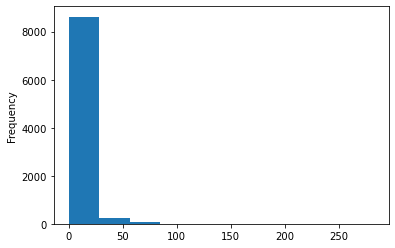

In [888]:
import matplotlib.pyplot as plt
import seaborn as sns
df_new['result'].plot(kind='hist')
plt.title = ("Distribution of cost across restaurants")

In [889]:
business_df

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
0,7402935,Skye,94,Jakarta,"Menara BCA, Lantai 56, Jl. MH. Thamrin, Thamri...","Grand Indonesia Mall, Thamrin","Grand Indonesia Mall, Thamrin, Jakarta",106.8220,-6.1968,"Italian, Continental",800000,Indonesian Rupiah(IDR),No,No,3,4.1000,Green,Very Good,1498
1,7410290,Satoo - Hotel Shangri-La,94,Jakarta,"Hotel Shangri-La, Jl. Jend. Sudirman","Hotel Shangri-La, Sudirman","Hotel Shangri-La, Sudirman, Jakarta",106.8190,-6.2033,"Asian, Indonesian, Western",800000,Indonesian Rupiah(IDR),No,No,3,4.6000,Dark Green,Excellent,873
2,7420899,Sushi Masa,94,Jakarta,"Jl. Tuna Raya No. 5, Penjaringan",Penjaringan,"Penjaringan, Jakarta",106.8001,-6.1013,"Sushi, Japanese",500000,Indonesian Rupiah(IDR),No,No,3,4.9000,Dark Green,Excellent,605
3,7421967,3 Wise Monkeys,94,Jakarta,"Jl. Suryo No. 26, Senopati, Jakarta",Senopati,"Senopati, Jakarta",106.8134,-6.2352,Japanese,450000,Indonesian Rupiah(IDR),No,No,3,4.2000,Green,Very Good,395
4,7422489,Avec Moi Restaurant and Bar,94,Jakarta,"Gedung PIC, Jl. Teluk Betung 43, Thamrin, Jakarta",Thamrin,"Thamrin, Jakarta",106.8210,-6.1963,"French, Western",350000,Indonesian Rupiah(IDR),No,No,3,4.3000,Green,Very Good,243
5,18352452,Lucky Cat Coffee & Kitchen,94,Jakarta,"Plaza Festival, South Parking, Jl. HR Rasuna S...","Plaza Festival, Kuningan","Plaza Festival, Kuningan, Jakarta",106.8317,-6.2189,"Cafe, Western",300000,Indonesian Rupiah(IDR),No,No,3,4.3000,Green,Very Good,458
6,18386856,Onokabe,94,Tangerang,"Alam Sutera Town Center, Jl. Alam Utama, Serpo...","Alam Sutera Town Center, Serpong Utara","Alam Sutera Town Center, Serpong Utara, Tangerang",106.6527,-6.2418,Indonesian,300000,Indonesian Rupiah(IDR),No,No,3,3.7000,Yellow,Good,155
7,7423482,Lemongrass,94,Bogor,"Jl. Raya Pajajaran No. 21, Bogor Utara, Bogor",Bogor Utara,"Bogor Utara, Bogor",106.8078,-6.5766,"Peranakan, Indonesian",250000,Indonesian Rupiah(IDR),No,No,3,4.0000,Green,Very Good,1159
8,18391256,MONKS,94,Jakarta,"Komplek Graha Boulevard Timur, Summarecon Kela...",Kelapa Gading,"Kelapa Gading, Jakarta",106.9113,-6.1639,"Western, Asian, Cafe",250000,Indonesian Rupiah(IDR),No,No,3,4.2000,Green,Very Good,259
9,7422633,Talaga Sampireun,94,Jakarta,Jl. Lingkar Luar Barat,Cengkareng,"Cengkareng, Jakarta",106.7285,-6.1685,"Sunda, Indonesian",200000,Indonesian Rupiah(IDR),No,No,3,4.9000,Dark Green,Excellent,1662


Approx 85% of the restuarants have a distribution cost for two is 0- 25 in terms of dollars. Other resturants are expensive in terms of average cost for two

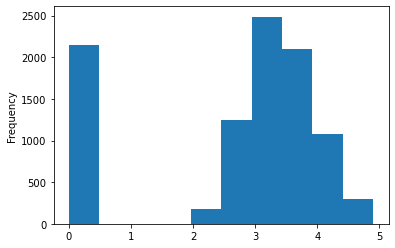

In [890]:
# distributed ratings among the various factors

import matplotlib.pyplot as plt
import seaborn as sns
business_df['Aggregate rating'].plot(kind='hist',alpha=1)
plt.title = ("Distribution of Ratings")

Around 26% of the resturants have around 3.5 rating and 1200 restaurants which have 4 rating above are popular among people which can be infer from above Histogram

In [891]:
business_df.describe(include = 'all')

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Price range,Aggregate rating,Rating color,Rating text,Votes
count,"9,542.0000",9541,"9,542.0000",9542,9542,9542,9542,"9,542.0000","9,542.0000",9542,"9,542.0000",9542,9542,9542,"9,542.0000","9,542.0000",9542,9542,"9,542.0000"
unique,NaN,7436,NaN,140,8910,1206,1263,NaN,NaN,1825,NaN,12,2,2,NaN,NaN,6,6,NaN
top,NaN,Cafe Coffee Day,NaN,New Delhi,"Sector 41, Noida",Connaught Place,"Connaught Place, New Delhi",NaN,NaN,North Indian,NaN,Indian Rupees(Rs.),No,No,NaN,NaN,Orange,Average,NaN
freq,NaN,83,NaN,5473,11,122,122,NaN,NaN,936,NaN,8652,8384,7091,NaN,NaN,3734,3734,NaN
mean,"9,043,300.5192",NaN,18.1792,NaN,NaN,NaN,NaN,64.2750,25.8485,NaN,"1,200.3261",NaN,NaN,NaN,1.8050,2.6652,NaN,NaN,156.7721
std,"8,791,967.3583",NaN,56.4516,NaN,NaN,NaN,NaN,41.1976,11.0101,NaN,"16,128.7439",NaN,NaN,NaN,0.9056,1.5166,NaN,NaN,430.2033
min,53.0000,NaN,1.0000,NaN,NaN,NaN,NaN,-157.9485,-41.3304,NaN,0.0000,NaN,NaN,NaN,1.0000,0.0000,NaN,NaN,0.0000
25%,"301,931.2500",NaN,1.0000,NaN,NaN,NaN,NaN,77.0816,28.4787,NaN,250.0000,NaN,NaN,NaN,1.0000,2.5000,NaN,NaN,5.0000
50%,"6,002,725.5000",NaN,1.0000,NaN,NaN,NaN,NaN,77.1920,28.5704,NaN,400.0000,NaN,NaN,NaN,2.0000,3.2000,NaN,NaN,31.0000
75%,"18,352,604.2500",NaN,1.0000,NaN,NaN,NaN,NaN,77.2820,28.6427,NaN,700.0000,NaN,NaN,NaN,2.0000,3.7000,NaN,NaN,130.0000


In [892]:
corr_matrix = business_df.corr()
print(corr_matrix["Aggregate rating"].sort_values(ascending=False))

Aggregate rating        1.0000
Price range             0.4384
Votes                   0.3135
Country Code            0.2813
Average Cost for two    0.0519
Latitude                0.0002
Longitude              -0.1147
Restaurant ID          -0.3272
Name: Aggregate rating, dtype: float64


<AxesSubplot:>

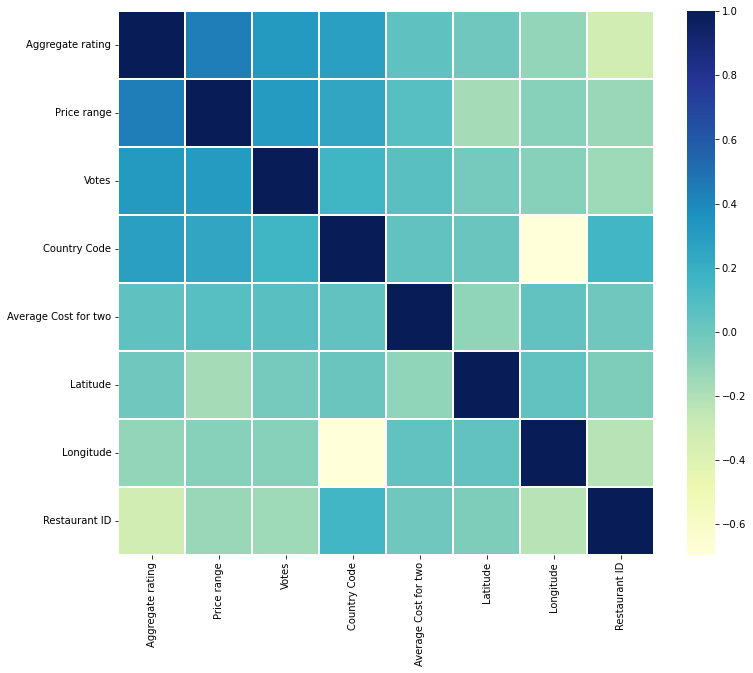

In [893]:
# the factors in the data that may have an effect on ratings

corrmat = business_df.corr(method ='pearson')


k = 20
  
cols = corrmat.nlargest(k, 'Aggregate rating')['Aggregate rating'].index
  
cm = np.corrcoef(business_df[cols].values.T)
f, ax = plt.subplots(figsize =(12, 10))
  
sns.heatmap(cm, ax = ax, cmap ="YlGnBu",
            linewidths = 0.1, yticklabels = cols.values, 
                              xticklabels = cols.values)

From above heatmap, we can infer that price range, vote, country code are the factors which have effect on ratings of a particular restuarant

In [907]:
print (business_df['Restaurant Name'].value_counts())

Cafe Coffee Day                                           83
Domino's Pizza                                            79
Subway                                                    63
Green Chick Chop                                          51
McDonald's                                                48
Keventers                                                 34
Pizza Hut                                                 30
Giani                                                     29
Baskin Robbins                                            28
Barbeque Nation                                           26
Giani's                                                   22
Barista                                                   22
Dunkin' Donuts                                            22
Costa Coffee                                              20
Pind Balluchi                                             20
Twenty Four Seven                                         19
Sagar Ratna             

In [908]:
# create a dataframe of top 10 categories
business_df_Top10 = business_df['Restaurant Name'].value_counts()[0:10].to_frame(name='frequency')
business_df_Top10=business_df_Top10.reset_index()


business_df_Top10.rename(index=str, columns={"index": "Restaurant Name", "frequency": "Frequency"}, inplace=True)
business_df_Top10

,Restaurant Name,Frequency
0,Cafe Coffee Day,83
1,Domino's Pizza,79
2,Subway,63
3,Green Chick Chop,51
4,McDonald's,48
5,Keventers,34
6,Pizza Hut,30
7,Giani,29
8,Baskin Robbins,28
9,Barbeque Nation,26


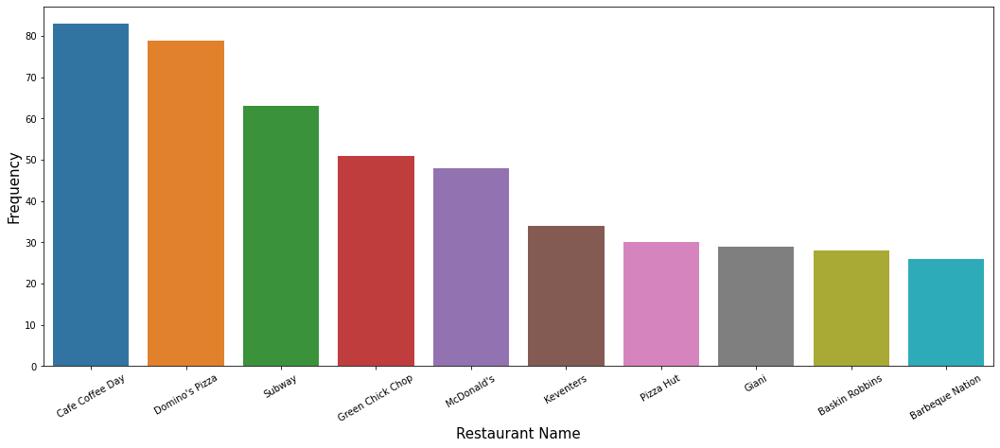

In [910]:
import seaborn as sns
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(18,7))
s=sns.barplot(x="Restaurant Name", y="Frequency", data= business_df_Top10)
s.set_xticklabels(s.get_xticklabels(), rotation=30)
plt.xlabel("Restaurant Name", fontsize=15)
plt.ylabel ("Frequency", fontsize=15)
plt.savefig("Most_Freq_Restaurant.png", dpi=300)
plt.show()

Use One Hot Encoding to Get More Information about the Venue Categories

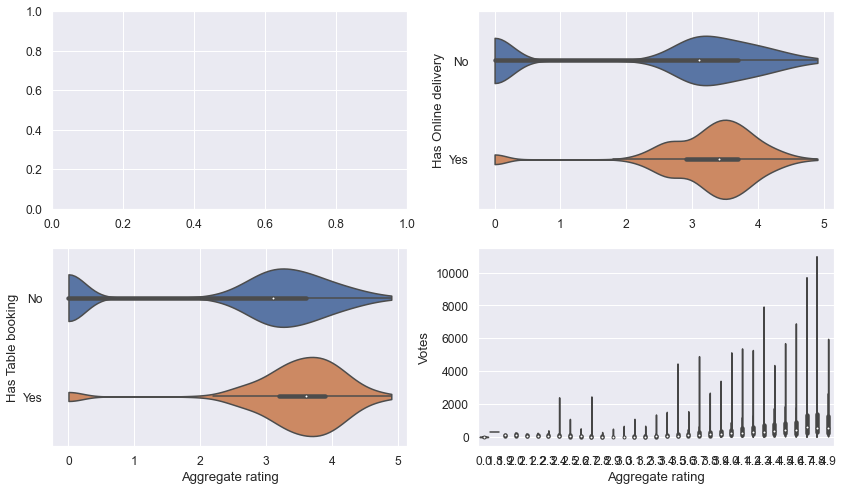

In [923]:
#statistical analysis

fig = plt.figure(figsize=(14,8))

sns.set(font_scale=1.1)
ax = plt.subplot(2,2,1)
ax = plt.subplot(2,2,2)
sns.violinplot(x="Aggregate rating", y="Has Online delivery", data=business_df, cut=0);
plt.xlabel("")
plt.subplot(2,2,3)
sns.violinplot(x="Aggregate rating", y="Has Table booking", data=business_df, cut=0);
plt.subplot(2,2,4)
sns.violinplot(x="Aggregate rating", y="Votes", data=business_df, cut=0);
plt.savefig ("Violin_plots_Dist_factors_affecting.png", dpi=240)
plt.show()

These above factors like Has table booking, delvery options and available cuisines have direct and indirect effect on  recommending a star restuarnts. From an interective dashboard an user can interect according to the locality in order to find out the aggregate rating of the restaurant and accordingly choose a star resturant in order to visit the same restaurant.

Factors like cost, delivery and table booking affects one restaurant rating, hence each city has one star resturant in a particluar cuisine. With preference and demand of particular cuisine or services offered by restuarnts the choice of star restaurant in a particular city changes.